# COVID-19: Countries Wealth, Cases, Deaths and Vaccines 
# 💲🦠⚰💉

🚧 NOTEBOOK IN PROGRESS 🚧

### Data Source:
Our World in Data (https://ourworldindata.org/, https://github.com/owid/covid-19-data/tree/master/public/data) \
You will not find data input for this notebook because it's reading the GitHub Repo from Our World in Data every time it's ran.

### EDA on:
1. Cases, Deaths, Vaccinations.
2. Reproduction Rate.
3. Stringency Index.
4. Vaccines used.
5. ... work in progress ...

### Questions
1. Do Wealthy countries have less cases?
2. Do Wealthy countries have less deaths?
3. Do Wealthy countries have more vaccines? Did they have them earlier?

# Importing Libraries

In [1]:
import numpy as np
np.set_printoptions(suppress=True)
import pandas as pd
pd.set_option('display.max_columns', None)
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import missingno as msno
from datetime import datetime
from datetime import date, timedelta
from sklearn.preprocessing import MinMaxScaler

# Datasets

In [2]:
# Reading the datasets

# Dataset 1: general compiled dataset (key=Co-Date)
df = pd.read_csv('https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/owid-covid-data.csv')
df['date'] = pd.to_datetime(df['date']).dt.date
df = df[df.iso_code.apply(lambda x: x[:5]!='OWID_')].copy()

# Dataset 2: vaccinations dataset for quantity of vaccines (key=Co-Date)
df_vacc_quantity= pd.read_csv('https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/vaccinations/vaccinations.csv')
df_vacc_quantity.dropna(subset=['iso_code'], inplace=True)
df_vacc_quantity = df_vacc_quantity[df_vacc_quantity.iso_code.apply(lambda x: x[:5]!='OWID_')]

# Dataset 3: vaccinations currently used by each country (key=Co)
df_vacc_type = pd.read_csv('https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/vaccinations/locations.csv')
#df_vacc_type = df_vacc_type[df_vacc_type.iso_code.apply(lambda x: x[:5]!='OWID_')].copy()

# Dataset 4: vaccinations by manufacturer (key=Co-Date-Vacc)
df_vacc_manuf = pd.read_csv('https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/vaccinations/vaccinations-by-manufacturer.csv')

In [3]:
key_check = len(df)==len(df[['iso_code', 'continent', 'location', 'date']].drop_duplicates())
print('OVERALL FIGURES')
print('Total countries: \t',len(df.location.unique()))
print('First date: \t\t', min(df.date).strftime('%Y-%m-%d'))
print('Last date: \t\t', max(df.date).strftime('%Y-%m-%d'))
print('Is key Country-Date?: \t', key_check)
print('Shape of the df table is:',df.shape)

OVERALL FIGURES
Total countries: 	 220
First date: 		 2020-01-01
Last date: 		 2021-06-18
Is key Country-Date?: 	 True
Shape of the df table is: (91514, 60)


Alright, so we know that we have a total of 220 countries.\
The first date in the dataset is January 1st of 2020.\
The last date in the dataset is Yesterday?\
The key is Country-Date, meaning that there is only 1 row for each day and country.\
More info about the columns of the dataset can be found in: \
https://github.com/owid/covid-19-data/blob/master/public/data/owid-covid-codebook.csv \
https://github.com/owid/covid-19-data/tree/master/public/data

I will now split the df in two dataframes, one country related and another one country&date. Meaning that one will be used for data particularly related with covid evolution and the other one with parameters from the country itself.

## Country indicators

In [4]:
# Defining df_co: dataframe with country related variables (independent of date)
co_related = ['iso_code', 'continent', 'location', 'population', 'population_density',
              'gdp_per_capita','life_expectancy', 'human_development_index']
df_co = df[co_related].drop_duplicates().reset_index(drop=True)
df_co.head(3)

,iso_code,continent,location,population,population_density,gdp_per_capita,life_expectancy,human_development_index
0,AFG,Asia,Afghanistan,38928341.0,54.422,1803.987,64.83,0.511
1,ALB,Europe,Albania,2877800.0,104.871,11803.431,78.57,0.795
2,DZA,Africa,Algeria,43851043.0,17.348,13913.839,76.88,0.748


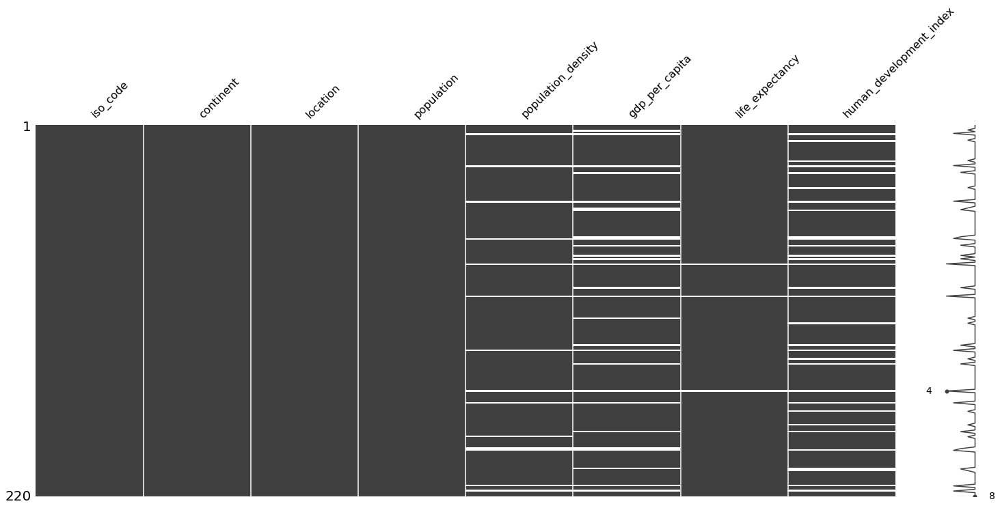

In [5]:
# Quick look at missing values
msno.matrix(df_co);

From this plot we can see that we have some missing values in the population_density, gdp_per_capita, life_expectancy and human_development_index but no so many. Meaning that this dataframe, the variables per countries are quite complete.

In [6]:
# Check countries with at least 1 missing value
df_co[df_co.isnull().any(axis=1)]

,iso_code,continent,location,population,population_density,gdp_per_capita,life_expectancy,human_development_index
3,AND,Europe,Andorra,77265.0,163.755,NaN,83.73,0.868
5,AIA,North America,Anguilla,15002.0,NaN,NaN,81.88,NaN
9,ABW,North America,Aruba,106766.0,584.800,35973.781,76.29,NaN
21,BMU,North America,Bermuda,62273.0,1308.820,50669.315,82.59,NaN
24,BES,North America,Bonaire Sint Eustatius and Saba,26221.0,NaN,NaN,77.79,NaN
28,VGB,North America,British Virgin Islands,30237.0,207.973,NaN,79.07,NaN
37,CYM,North America,Cayman Islands,65720.0,256.496,49903.029,83.92,NaN
45,COK,Oceania,Cook Islands,17564.0,NaN,NaN,76.25,NaN
49,CUB,North America,Cuba,11326616.0,110.408,NaN,78.80,0.783
50,CUW,North America,Curacao,164100.0,362.644,NaN,78.88,NaN


## Country-Date cases, deaths, tests, vaccinations, reproduction rate, stringency index

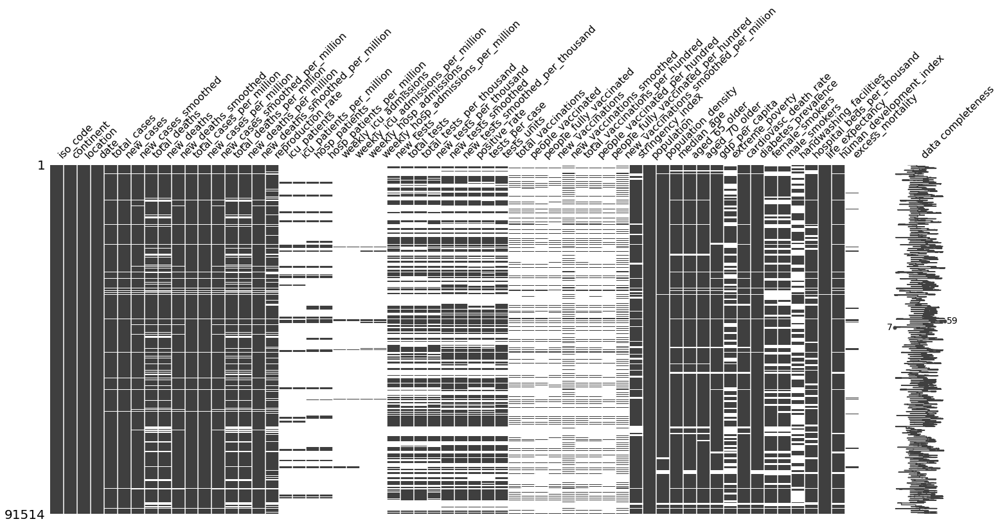

In [7]:
# Quick look at missing values in df
msno.matrix(df, labels=True);

Thanks to this plot, we can easily se that there are a lot of missing values for ICU/hospitalized patience. This may be explained due to several countries not reporting it. That is why those columns will not be used further in this notebooks and will be dropped straight away. \
Similarly, we can see high number of missing values in the columns related with the vaccinations. In this case, the reason is not the same as before, instead this could be explained due to vaccines only available in 2021, but covid started since 2019/20. \
Furthermore, we can also see missing values in the tests columns. This can be explained due to two factors, some countries did not report the tests performed at all, and some other reported in a less frequent base than daily (for example, weekly).

In [8]:
# Defining df_co_dt: dataframe with country AND date related variables (date dependant)
# Droppping all ICU because they have lot of missing values and it is not scope of this notebook.
co_dt_related = ['iso_code', 'continent', 'location', 'date', 
                 'total_cases', 'new_cases','total_deaths', 'new_deaths', 'total_tests', 'new_tests',
                 'total_cases_per_million','new_cases_per_million','total_deaths_per_million', 
                 'new_deaths_per_million','total_tests_per_thousand', 'new_tests_per_thousand',
                 'total_vaccinations','people_vaccinated', 'people_fully_vaccinated', 'new_vaccinations',
                 'total_vaccinations_per_hundred','people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
                 'reproduction_rate', 
                 'stringency_index']
df_co_dt = df[co_dt_related].drop_duplicates().reset_index(drop=True)
df_co_dt.head(3)

,iso_code,continent,location,date,total_cases,new_cases,total_deaths,new_deaths,total_tests,new_tests,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,total_tests_per_thousand,new_tests_per_thousand,total_vaccinations,people_vaccinated,people_fully_vaccinated,new_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,reproduction_rate,stringency_index
0,AFG,Asia,Afghanistan,2020-02-24,1.0,1.0,NaN,NaN,NaN,NaN,0.026,0.026,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.33
1,AFG,Asia,Afghanistan,2020-02-25,1.0,0.0,NaN,NaN,NaN,NaN,0.026,0.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.33
2,AFG,Asia,Afghanistan,2020-02-26,1.0,0.0,NaN,NaN,NaN,NaN,0.026,0.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.33


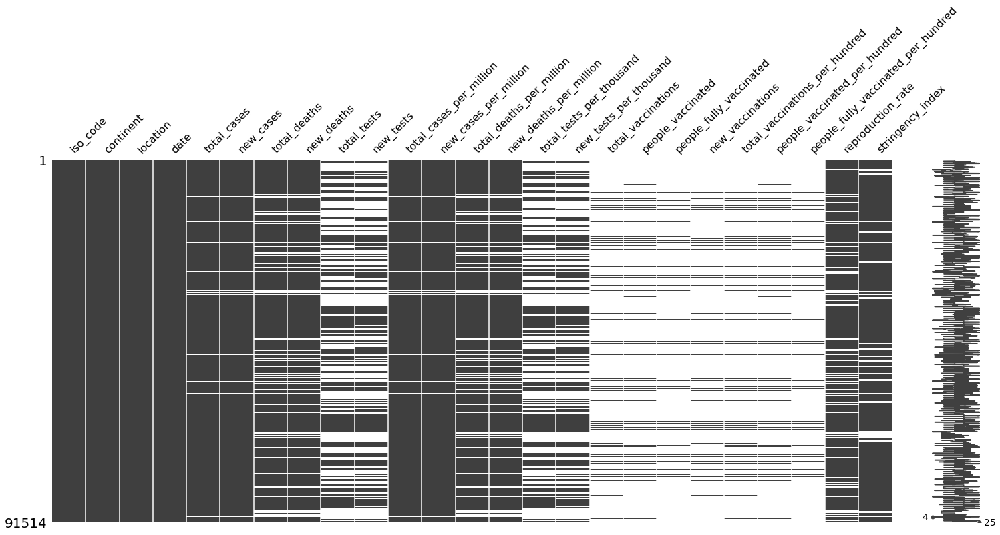

In [9]:
# Quick look at missing values
msno.matrix(df_co_dt);

In [10]:
ww_cases = df_co_dt.new_cases.sum()
ww_deaths = df_co_dt.new_deaths.sum()
ww_vaccinations = df_co_dt.new_vaccinations.sum()
print('Current acumulated Worldwide figures:')
print('Cases:\t\t',f'{int(ww_cases):,}')
print('Deaths:\t\t',f'{int(ww_deaths):,}')
print('Vaccinations:\t',f'{int(ww_vaccinations):,}')

Current acumulated Worldwide figures:
Cases:		 177,242,400
Deaths:		 3,849,225
Vaccinations:	 2,276,386,827


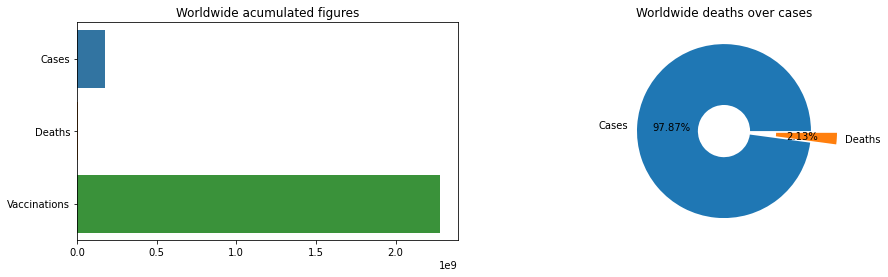

In [11]:
fig, ax = plt.subplots(1, 2, figsize=(15, 4))
sns.barplot(x=[ww_cases, ww_deaths, ww_vaccinations], y=['Cases','Deaths', 'Vaccinations'], 
            ax=ax[0]).set_title('Worldwide acumulated figures')
#check notation of xticks
ax[1].pie(x=[ww_cases,ww_deaths], labels=['Cases','Deaths'], autopct='%.2f%%',
          explode=(0, 0.3), wedgeprops=dict(width=0.7))
plt.title('Worldwide deaths over cases')
plt.show()

This plots are quite simple, but provides a quick overview of the current situation of Covid. Where we can see that vaccines, finally, vaccinations have overcame - by far -  the quantity of cases. \
Parallelly, the pie chart on the right hand, show small porcentage (yet relevant and important) of deaths among positive cases reported.

# Vaccinations

In [12]:
df_vacc = df_vacc_quantity.merge(df_vacc_type[['location','vaccines']], how='left').merge(
    df_co[['location','continent', 'population', 'population_density',
           'gdp_per_capita', 'life_expectancy', 'human_development_index']], how='left')
df_vacc['date'] = pd.to_datetime(df_vacc['date']).dt.date
df_vacc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24497 entries, 0 to 24496
Data columns (total 19 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   location                             24497 non-null  object 
 1   iso_code                             24497 non-null  object 
 2   date                                 24497 non-null  object 
 3   total_vaccinations                   13559 non-null  float64
 4   people_vaccinated                    12838 non-null  float64
 5   people_fully_vaccinated              10109 non-null  float64
 6   daily_vaccinations_raw               11128 non-null  float64
 7   daily_vaccinations                   24210 non-null  float64
 8   total_vaccinations_per_hundred       13559 non-null  float64
 9   people_vaccinated_per_hundred        12838 non-null  float64
 10  people_fully_vaccinated_per_hundred  10109 non-null  float64
 11  daily_vaccinations_per_milli

In [13]:
#Top Countries on Total Vaccinations
n=20
data = df_vacc.groupby('location').max().sort_values(by='total_vaccinations', ascending=False).reset_index()\
            [['location','total_vaccinations','gdp_per_capita']][:n]
fig = px.bar(data, 
             x="location", 
             y="total_vaccinations", 
             orientation='v' 
#             ,color='greens'                
#             ,color_continuous_scale = 'blues'
             ,title='<b>Top {} countries in Total Vaccinations</b>'.format(n)
            )
fig.update_layout(yaxis={'categoryorder':'category descending'})
fig.update_traces(marker_color='green')
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)'})
fig.show()

This plot tell us the countries that have applied the most quantity of vaccines to date. It is biased due to the population of each of them. The bigger the country, the more vaccinations, but not necessarily is the one that is doing that best.

In [14]:
#Top Countries on Total Vaccinations per Hundred
n=20
data = df_vacc.groupby('location').max().sort_values(by='total_vaccinations_per_hundred', ascending=False).reset_index()\
            [['location','total_vaccinations_per_hundred','gdp_per_capita']][:n]
fig = px.bar(data, 
             x="location", 
             y="total_vaccinations_per_hundred", 
             orientation='v' 
#             ,color='gdp_per_capita'                
#             ,color_continuous_scale = 'blues'
             ,title='<b>Top {} countries on Total Vaccinations per Hundred</b>'.format(n)
            )
fig.update_layout(yaxis={'categoryorder':'category descending'})
fig.update_traces(marker_color='green')
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)'})
fig.show()

Similar to previous plot, but this time it is normalized by the population of the country. So one can really see which countries are doing it best (possibly smaller countries find it easier/faster to vaccinate the whole population). 

In [15]:
#Map - Total Vaccionations per Hundred
data = df_vacc.groupby(by='location').max().reset_index()[['location','total_vaccinations_per_hundred']]

fig = px.choropleth(data,
                    locations = 'location', 
                    locationmode = 'country names',
                    color = 'total_vaccinations_per_hundred',
                    title = '<b>Total Vaccinations per Hundred</b>',
                    color_continuous_scale = 'greens',
                    hover_name = 'location'
                    ,labels={'total_vaccinations_per_hundred':'% Vacc'}
                   )
fig.show()

Now we can see the same information as in the previous plot, but in a map which makes it easy have all the information in one view.

In [16]:
#Top Countries on Daily Vaccinations per Million in the last 7 days
days_to_subtract = 7
dt_today = date.today()
dt_since = dt_today - timedelta(days=days_to_subtract)
data = df_vacc[df_vacc.date>=dt_since]

#Top Countries on Daily Vaccinations per million
n=20
data = df_vacc.groupby('location').max().sort_values(by='daily_vaccinations_per_million', ascending=False).reset_index()\
            [['location','daily_vaccinations_per_million','gdp_per_capita']][:n]
fig = px.bar(data, 
             x="location", 
             y="daily_vaccinations_per_million", 
             orientation='v' 
#             ,color='gdp_per_capita'                
#             ,color_continuous_scale = 'blues'
             ,title='<b>Top {} countries with more Daily Vaccinations per Million in the last {} days</b>'.format(n, days_to_subtract)
            )
fig.update_layout(yaxis={'categoryorder':'category descending'})
fig.update_traces(marker_color='green')
fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)'})
fig.show()

From this plot we can see which countries are currently (from last 7 days) vaccinating at a higher pace, considering the population of the country.

In [17]:
#Map - Daily Vaccionations per Hundred
days_to_subtract = 7
dt_today = date.today()
dt_since = dt_today - timedelta(days=days_to_subtract)
data = df_vacc[df_vacc.date>=dt_since]

data = data[['location','daily_vaccinations_per_million']].groupby(by=['location']).max().reset_index()
#data['daily_vaccinations_per_hundred'] = round((data['daily_vaccinations']*100) / data['population'],4)

fig = px.choropleth(data,
                    locations = 'location', 
                    locationmode = 'country names',
                    color = 'daily_vaccinations_per_million',
                    title = '<b>Daily Vaccinations per Million in the last {} days</b>'.format(days_to_subtract),
                    color_continuous_scale = 'greens',
                    hover_name = 'location'
                    ,labels={'daily_vaccinations_per_million':'Vacc / M'}
                   )
fig.show()

From this map we can see which countries are vaccinating more, considering the lasts 7 days and the population of the countries.

# Scatters

In [18]:
def plot_custom_scatter(df, x, y, size, color, hover_name, title):
    '''
    INPUT:
        df - Pandas dataframe - contains the data
        x - string - name of the column to be used as horizontal axis
        y - string - name of the column to be used as vertical axis
        size - string - name of the column to be used to define the size of the bubbles
        color - string - name of the column to be used to define the color of the bubbles
        hover_name - string - name of the column to be used to display when hover on top of the bubbles
        title - string - title of the plot
    OUTPUT:
        plot
        
    Description: the function plots a custom scatter plot with Plotly Express
    '''
    fig = px.scatter(df, x=x, y=y, size=size, color=color,
               hover_name=hover_name, size_max=80, title = title
#                     ,width=800
                     ,height=800
                    )
    fig.update_layout({'legend_orientation':'h'})
    fig.update_layout(legend=dict(yanchor="top", y=-0.1))
    fig.update_layout({'legend_title':'Continent'})
    fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)'})
    fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True)
    fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True)
    fig.update_xaxes(zeroline=True, zerolinewidth=0.5, zerolinecolor='grey')
    fig.update_yaxes(zeroline=True, zerolinewidth=0.5, zerolinecolor='grey')
    fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey')
    fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey')
    fig.update_traces(marker=dict(symbol='circle-dot',opacity=0.5, line=dict(width=1,color='Black')))
    fig.show()    

In [19]:
# Scatter Vaccination Acumulated Total vs Porcentual, Color per Continent
data = df_vacc.groupby('location').max().reset_index()[['location','continent','total_vaccinations',
       'total_vaccinations_per_hundred', 'vaccines']].dropna()

plot_custom_scatter(data, 
                    x = 'total_vaccinations', 
                    y = 'total_vaccinations_per_hundred', 
                    size = 'total_vaccinations', 
                    color = 'continent',
                    hover_name = 'location', 
                    title = '<b>Vaccinations Acum (Total vs Percent), per continent</b>')

From this plot we can see the relation between the total vaccinations and the total vaccinations considering the population of the country. We can't identify a relation with the continents. It's mainly descriptive, but not much to infer from this plot.

In [20]:
# Scatter Vaccination Rate Total vs Porcentual, Color per type of vaccine
days_to_subtract = 7
dt_today = date.today()
dt_since = dt_today - timedelta(days=days_to_subtract)
data = df_vacc[df_vacc.date>=dt_since]

data = data[['location','continent','total_vaccinations','daily_vaccinations','vaccines','population']].groupby(by='location').max().reset_index().dropna()
data['total_vaccinations_per_million'] = round((data['total_vaccinations']*1000000) / data['population'],0)
data['daily_vaccinations_per_million'] = round((data['daily_vaccinations']*1000000) / data['population'],0)

plot_custom_scatter(data, 
                    x = 'total_vaccinations_per_million', 
                    y = 'daily_vaccinations_per_million', 
                    size = 'total_vaccinations_per_million', 
                    color = 'continent',
                    hover_name = 'location', 
                    title = '<b>Vaccinations Rate (Total vs Daily per million), per continent</b>')

Since the colors represent the continents, we can identify certain aligment withing the European country, meaning that countries in Europe seems to be vaccinating at a relatively similar pace when it comes to daily vaccinations, as well as the accumulated vaccinations. \
We can also identify that African countries seem to be in the bottom left of the chart, which is unfortunately low vaccinations accumulated and daily (except Seychelles). \
Apart from this two observations, the rest of the datapoints seem dispersed to draw conclusions only with it.

In [21]:
data = df_vacc[['continent','location','total_vaccinations','vaccines']].groupby(by=['continent','location','vaccines']).max().reset_index()
data['world'] = 'World'
data

fig = px.treemap(data, 
                 path = ['world', 'vaccines', 'location'], 
                 values = 'total_vaccinations',
#                 hover_name = 'location',
#                 color = 'gdp_per_capita',
                 color_continuous_scale = 'RdBu',
                 title = '<b>Total vaccinations per schema</b>'
                 ,color_discrete_sequence = px.colors.qualitative.Pastel
#                ,labels={'gdp_per_capita':'GDP per capita'}
                )

fig.show()

With this treemap, we can see how much a vaccination schema is used in total. This treemap is a bit misleading due to few countries reporting how many dosis per vaccine were applied (per day or total), hence if a country is applying 10% of a certain vaccine and 90% of another one (supposing only 2 for this example), by looking at the plot you may thing that it is applying 50% of each when that's not the case. 

In [22]:
data = df_vacc[['continent','location','total_vaccinations_per_hundred','vaccines']].groupby(by=['continent','location','vaccines']).max().reset_index()
data['world'] = 'World'

fig = px.treemap(data, 
                 path = ['world', 'vaccines', 'location'], 
                 values = 'total_vaccinations_per_hundred',
#                 hover_name = 'location',
#                 color = 'gdp_per_capita',
                 color_continuous_scale = 'RdBu',
                 title = '<b>Total vaccinations per million per schema</b>'
                 ,color_discrete_sequence = px.colors.qualitative.Pastel
#                ,labels={'gdp_per_capita':'GDP per capita'}
                )

fig.show()

This plot is similar to the one before, but considering the population of the countries

# Cases

In [23]:
data = df[['iso_code','continent','location','total_cases','population']].groupby(by=['iso_code','continent','location']).max().reset_index()
data['total_cases_per_million'] = round((data['total_cases']*1000000) / data['population'],0)

fig = px.choropleth(data,
                    locations = 'location', 
                    locationmode = 'country names',
                    color = 'total_cases_per_million',
                    title = '<b>Total cases per million habitants</b>',
                    color_continuous_scale = 'reds',
                    hover_name = 'location'
                    ,labels={'total_cases_per_million':'Total cases per million'}
                   )
fig.show()

Here we can have an overall view of the covid cases per million habitant. We can see highly affected areas in South America, Europe and USA.

In [24]:
days_to_subtract = 7
dt_today = date.today()
dt_since = dt_today - timedelta(days=days_to_subtract)
data = df[df.date>=dt_since]

data = data[['iso_code','continent','location','new_cases','population']].groupby(by=['iso_code','continent','location']).max().reset_index()
data['new_cases_per_million'] = round((data['new_cases']*1000000) / data['population'],0)

fig = px.choropleth(data,
                    locations = 'location', 
                    locationmode = 'country names',
                    color = 'new_cases_per_million',
                    title = '<b>Daily new cases per million habitants</b>',
                    color_continuous_scale = 'reds',
                    hover_name = 'location'
                    ,labels={'new_cases_per_million':'Daily cases per million'}
                   )
fig.show()

This plot pretends to show which are the countries where currently present higher daily cases. 

# Evolution over Time of tests, cases, deaths and vaccinations

In [25]:
data = df.groupby('date').sum()[['new_tests_smoothed','new_cases_smoothed',
                                 'new_deaths_smoothed','new_vaccinations_smoothed']]
data.columns= ['Tests','Cases','Deaths','Vaccinations']
fig = px.line(data, color_discrete_sequence=['grey','blue','red','green'], 
              title='<b>Worldwide daily evolution of Tests, Cases, Deaths and Vaccinations</b>')
fig.show()

With this plot we can see the overall figures evolution across time.

# GDP, Treemaps

In [26]:
data = df[['iso_code','continent','location','total_cases','gdp_per_capita','population']].groupby(by=['iso_code','continent','location']).max().reset_index()
data['total_cases_per_million'] = round((data['total_cases']*1000000) / data['population'],0)
data['world'] = 'World'

fig = px.treemap(data, 
                 path = ['world', 'continent', 'location'], 
                 values = 'total_cases_per_million',
#                 hover_name = 'location',
                 color = 'gdp_per_capita',
                 color_continuous_scale = 'RdBu',
                 title = '<b>Total cases per Million and GDP per capita</b>'
                ,labels={'gdp_per_capita':'GDP per capita'}
                )

fig.show()

From this coloured treemap, I was expecting to see some relation with the GDP, accumulated cases and the continents but it is not the case. There is not trend I can highlight.

In [27]:
days_to_subtract = 7
dt_today = date.today()
dt_since = dt_today - timedelta(days=days_to_subtract)
data = df[df.date>=dt_since]

data = data[['iso_code','continent','location','new_cases','gdp_per_capita','population']].groupby(by=['iso_code','continent','location']).max().reset_index()
data['daily_cases_per_million'] = round((data['new_cases']*1000000) / data['population'],0)
data['world'] = 'World'
#data = data[data.new_cases.notnull()]
#data=data.dropna()

fig = px.treemap(data, 
                 path = ['world', 'continent', 'location'], 
                 values = 'daily_cases_per_million',
#                 hover_name = 'location',
#                 color = 'gdp_per_capita',
#                 color_continuous_scale = 'RdBu',
                 title = '<b>Daily cases per million</b>'#and GDP per capita</b>'
                 ,labels={'gdp_per_capita':'GDP per capita'}
                 ,color_discrete_sequence = px.colors.qualitative.Pastel
                )

fig.show()

This treemap, shows which countries are currently having more daily cases, grouped by continents. It is similar to the "Daily new cases per million habitants" map, but in here we can see better the scales. In the map, small countries could hardly be seen in a color scale, while here its size is easier to understsand and call attention.

# Stringency Index
This is a composite measure based on nine response indicators including school closures, workplace closures, and travel bans, rescaled to a value from 0 to
100 (100 = strictest). If policies vary at the subnational level, the index is shown as the response level of the strictest sub-region.

In [28]:
data = df_co_dt[['iso_code','continent','location','date','stringency_index']].copy()
data['date'] = pd.to_datetime(data['date']).dt.strftime('%m/%d/%Y')
#data
fig = px.choropleth(data, 
                    locations = 'location',
                    color = 'stringency_index', 
                    animation_frame = 'date',
                    color_continuous_scale = 'blues',
                    locationmode = 'country names',
                    range_color = [0, 100],
                    title = '<b>Stringency Index variation over time</b>',
                    hover_name = 'location'
                    ,labels={'stringency_index':'Stringency'}
                    )
#fig.update_layout(transition = {'duration': 5})
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 30
fig.layout.updatemenus[0].buttons[0].args[1]['transition']['duration'] = 2

fig.show()

Above animated map, shows how the severity of restrictions evolved in each of the countries.

# Reproduction Rate

In [29]:
data = df_co_dt[['iso_code','continent','location','date','reproduction_rate']].copy()
data['date'] = pd.to_datetime(data['date']).dt.strftime('%m/%d/%Y')
#data
fig = px.choropleth(data, 
                    locations = 'location',
                    color = 'reproduction_rate', 
                    animation_frame = 'date',
                    color_continuous_scale = 'reds',
                    locationmode = 'country names',
                    range_color = [0, 3],
                    title = '<b>Reproduction Rate variation over time</b>',
                    hover_name = 'location'
                    ,labels={'reproduction_rate':'Rate'}
                    )
#fig.update_layout(transition = {'duration': 5})
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 30
fig.layout.updatemenus[0].buttons[0].args[1]['transition']['duration'] = 2

fig.show()

Above animated map, shows how the reproduction rate evolved in each of the countries.

# Correlation

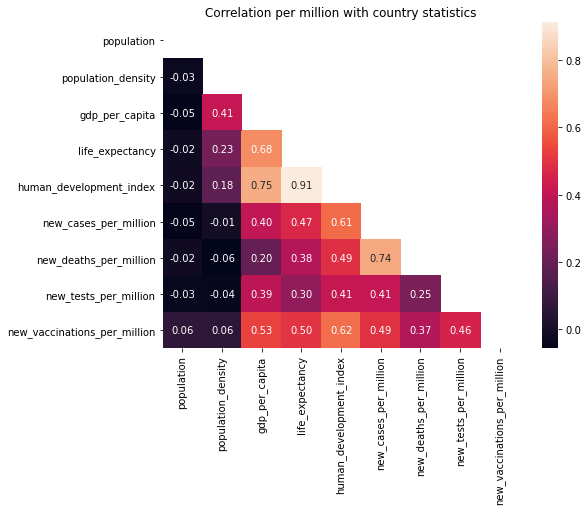

In [30]:
variables = ['new_cases','new_deaths','new_tests','new_vaccinations']

plt.figure(figsize=(8,6))

data = df_co_dt[['location']+variables].groupby(by='location').sum().merge(df_co, left_on='location',right_on='location')
for variable in variables:
    data[variable+'_per_million'] = (data[variable]*1000000) / data.population
    data.drop(columns=variable, inplace=True)
#data = cases[['cases_per_million','population','population_density','gdp_per_capita','life_expectancy','human_development_index']]
mask = np.triu(np.ones_like(data.corr(), dtype=bool))
sns.heatmap(data.corr(), annot=True, fmt='.2f', mask=mask)#,cmap='viridis')
plt.title('Correlation per million with country statistics')
plt.show()

This heatmap plots the Pearson correlation indexes for the different main indicators. Again, I was epecting to see more cases or deaths in less develop / low-income countries, but that is not the case (or not strong enought to my eyes).

# Questions
1. Do Wealthy countries have less cases?
2. Do Wealthy countries have less deaths?
3. Do Wealthy countries have more vaccines? Did they have them earlier?

In [31]:
labels = ['low','lower-middle','upper-middle','high']
bin_data = df_co.copy()
bin_data['gdp_bin'] = pd.qcut(df_co.gdp_per_capita
                              ,q=4
                              ,labels=labels
                             )
for label in labels:
    print('Bucket {}:'.format(label))
    print(bin_data[bin_data.gdp_bin==label].location.values)

Bucket low:
['Afghanistan' 'Bangladesh' 'Benin' 'Burkina Faso' 'Burundi' 'Cambodia'
 'Cameroon' 'Central African Republic' 'Chad' 'Comoros' "Cote d'Ivoire"
 'Democratic Republic of Congo' 'Djibouti' 'Eritrea' 'Ethiopia' 'Gambia'
 'Guinea' 'Guinea-Bissau' 'Haiti' 'Kenya' 'Kiribati' 'Kyrgyzstan'
 'Lesotho' 'Liberia' 'Madagascar' 'Malawi' 'Mali' 'Marshall Islands'
 'Mauritania' 'Micronesia (country)' 'Mozambique' 'Nepal' 'Niger'
 'Papua New Guinea' 'Rwanda' 'Sao Tome and Principe' 'Senegal'
 'Sierra Leone' 'Solomon Islands' 'South Sudan' 'Tajikistan' 'Tanzania'
 'Togo' 'Tuvalu' 'Uganda' 'Vanuatu' 'Yemen' 'Zambia' 'Zimbabwe']
Bucket lower-middle:
['Albania' 'Angola' 'Armenia' 'Belize' 'Bhutan' 'Bolivia'
 'Bosnia and Herzegovina' 'Cape Verde' 'Congo' 'Dominica' 'Ecuador'
 'Egypt' 'El Salvador' 'Eswatini' 'Fiji' 'Georgia' 'Ghana' 'Guatemala'
 'Guyana' 'Honduras' 'India' 'Indonesia' 'Jamaica' 'Jordan' 'Laos'
 'Moldova' 'Mongolia' 'Morocco' 'Myanmar' 'Namibia' 'Nicaragua' 'Nigeria'
 'Pakistan'

In [32]:
data = bin_data[['location','gdp_bin']].dropna()

fig = px.choropleth(data
                    ,locations = 'location'
                    ,locationmode = 'country names'
                    ,color = 'gdp_bin'
                    ,title = '<b>Countries Wealth</b>'
                    ,color_discrete_sequence=['red','orange','lightblue','darkblue'] 
                    ,hover_name = 'location'
                   )
fig.update_layout({'legend_orientation':'h'})
fig.show()

In [33]:
def wrap_plot_gdp(variable, date_start='2020-01-01'):    
    '''
    INPUT:
        variable - string - name of the column to be used as values for the lineplot (y axis)
        date_start - string - optional - if none, will plot from first data point. 
            If a date, will render only after that date
    OUTPUT:
        plot
        
    Description: the function wrap and plot the data from the df and renders
    a custom line plot with Plotly Express that shows the evolution of a certain
    variable from the dataframe over time. 
    Optionally, a custom date start can be passed to filter only after that date.
    '''
    labels = ['low','lower-middle','upper-middle','high']
    bin_data = df_co.copy()
    bin_data['gdp_bin'] = pd.qcut(df_co.gdp_per_capita
                                  ,q=4
                                  ,labels=labels
                                 )
    data = df[['location','date']+[variable]].merge(bin_data[['location','gdp_bin']])
    data['date'] = pd.to_datetime(data['date'])
    data = data[data.date>date_start]
    data = data.groupby(['date','gdp_bin']).mean().reset_index()
    data = data.pivot(index='date', columns='gdp_bin', values=variable)

    #plot
    fig = px.line(data
                  ,color_discrete_sequence=['red','orange','blue','darkblue'] 
                  ,title='<b>{} vs gdp_bin</b>'.format(variable)
                  ,labels={'value':variable}
                 )
    fig.update_layout({'legend_orientation':'h'})
    fig.show()

## 1. Do Wealthy countries have less cases?

In [34]:
wrap_plot_gdp(variable='new_cases_smoothed_per_million')

In [35]:
wrap_plot_gdp(variable='total_cases_per_million')

From the above two plots, we can see that the wealthier the country, the earlier it reported Covid19 cases. We can also see that around May2021, there is a drastic reduction on the high-income countries, possible due to the vaccines. From the second chart, we can see that the high-income countries show more quantity of population tested positive.

## 2. Do Wealthy countries have less deaths?

In [36]:
wrap_plot_gdp(variable='new_deaths_smoothed_per_million')

In [37]:
wrap_plot_gdp(variable='total_deaths_per_million')

When it comes to deaths, we can see a big and early spike for high-income countries with a drastically reduction around July2020. Again, in January2021 they presented more deaths than other lower income countries. 
Something that caught my attention in the two plots, is the significantly lower deaths in the lowest income countries. A possible explanation could be that the figures do not reflect what actually happened / is happening in reality.

## 3. Do Wealthy countries have more vaccines? Did they have them earlier?

In [38]:
wrap_plot_gdp(variable='new_vaccinations_smoothed_per_million', date_start='2020-12-01')

In [39]:
wrap_plot_gdp(variable='total_vaccinations_per_hundred', date_start='2020-12-01')

For vaccinations, we can see again higher numbers for high-income countries. It is not only clear that they are having more vaccines than the lower groups, but also that they started to have them earlier. This may be attributable, among other causes, to the fact that some high-income countries were the firsts ones to develop the vaccine (prioritizing their own population), or also that these countries were able to pay higher prices in order to get the shots sooner. 

## Thanks for reading!